In [1]:
import matplotlib.pyplot as plt
from astromodule.io import read_image, write_image
from pylegs.io import read_table
import numpy as np
from astropy.coordinates import Angle, Galactic, ICRS
from astropy import units as u
from pylegs.utils import guess_coords_columns
import dask.dataframe as dd
from scipy.stats import gaussian_kde
from pylegs.pixscale import (
  correction_factor_circle, correction_factor_ellipse, compute_fov_circ, 
  compute_pixscale_circle, draw_circle, compute_fov_ellip, 
  compute_pixscale_ellip, draw_ellipse
)
from pylegs.cutout import cutout, batch_cutout
from pylegs.utils import iauname_path, iauname
import pandas as pd
from pathlib import Path
from astromodule.splus import SplusService
import os
from pylegs import configs
import scienceplots
from matplotlib.patches import Circle
import requests
from io import StringIO, BytesIO
from PIL import Image
from typing import Literal
import seaborn as sns
import matplotlib.ticker as mtick
from sklearn.metrics import ConfusionMatrixDisplay
import sys

plt.style.use(['science','ieee'])
plt.rcParams.update({
  "text.usetex": True,
  "font.family": "Palatino",
})

In [4]:
RA_LABELS = ['14h','16h','18h','20h','22h','0h','2h','4h','6h','8h','10h']
title_fontsize = 16
label_fontsize = 12
xlabelpad = 9

def plot_mw(ax: plt.Axes):
  mw = Galactic(l=np.linspace(0, 360, 200)*u.deg, b=np.zeros(shape=(200,))*u.deg)
  mw = mw.transform_to(ICRS())
  ra_mw = Angle(mw.ra)
  ra_mw = ra_mw.wrap_at(180*u.deg)
  dec_mw = Angle(mw.dec)
  ax.scatter(ra_mw.rad, dec_mw.rad, c='k', alpha=0.6, marker='o', s=1)
  
  

SPLUS_COLOR = '#618AD5'
LEGACY_COLOR = '#618AD5'
SDSS_COLOR = '#618AD5'

  

def plot_splus_footprint(ax:plt.Axes = None, save_path=None):
  if ax is None:
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111, projection='hammer')
  
  df = read_table('~/Downloads/iDR5_pointings.csv')

  ra = Angle(df['RA_d'].values*u.deg)
  ra = ra.wrap_at(180*u.deg)
  dec = Angle(df['DEC_d'].values*u.deg)

  ax.scatter(ra.rad, dec.rad, marker='s', c=SPLUS_COLOR, s=30, rasterized=True)

  ytickslabels = ax.yaxis.get_ticklabels()
  ytickslabels[0].set_text('')
  ytickslabels[-1].set_text('')
  ax.set_yticklabels(ytickslabels)
  ax.set_xticklabels(RA_LABELS)
  ax.grid(True, color='k', alpha=0.3, linestyle=':')
  ax.set_xlabel('Ascenção Reta (J2000)', fontsize=label_fontsize, labelpad=xlabelpad)
  ax.set_ylabel('Declinação (J2000)', fontsize=label_fontsize)
  # ax.set_title('S-PLUS DR5', fontsize=title_fontsize)
  plot_mw(ax)
  if save_path:
    plt.savefig(save_path, bbox_inches='tight', pad_inches=0.01)
  
  
  
  
def plot_legacy_footprint(ax:plt.Axes = None, save_path=None):
  if ax is None:
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111, projection='hammer')
  
  df = read_table('~/Downloads/survey-bricks-dr10-south.fits.gz', fmt='fits')
  df = df[df.survey_primary & (df.nexp_g > 0) & (df.nexp_r > 0) & (df.nexp_z > 0)]

  ra = Angle(df['ra'].values*u.deg)
  ra = ra.wrap_at(180*u.deg)
  dec = Angle(df['dec'].values*u.deg)
  
  ax.scatter(ra.rad, dec.rad, marker='s', s=15, c=LEGACY_COLOR, rasterized=True)

  df = read_table('~/Downloads/survey-bricks-dr9-north.fits.gz', fmt='fits')
  df = df[df.survey_primary & (df.nexp_g > 0) & (df.nexp_r > 0) & (df.nexp_z > 0)]
  ra = Angle(df['ra'].values*u.deg)
  ra = ra.wrap_at(180*u.deg)
  dec = Angle(df['dec'].values*u.deg)

  ax.scatter(ra.rad, dec.rad, marker='s', s=15, c=LEGACY_COLOR, rasterized=True)

  ytickslabels = ax.yaxis.get_ticklabels()
  ytickslabels[0].set_text('')
  ytickslabels[-1].set_text('')
  ax.set_yticklabels(ytickslabels)
  ax.set_xticklabels(RA_LABELS)
  ax.grid(True, color='k', alpha=0.3, linestyle=':')
  ax.set_xlabel('Ascenção Reta (J2000)', fontsize=label_fontsize, labelpad=xlabelpad)
  ax.set_ylabel('Declinação (J2000)', fontsize=label_fontsize)
  # ax.set_title('Legacy Survey DR10', fontsize=title_fontsize)
  ax.set_title('Cobertura espacial')
  plot_mw(ax)
  if save_path:
    plt.savefig(save_path, bbox_inches='tight', pad_inches=0.01)
  
  
  
  
  
def plot_sdss_footprint(ax: plt.Axes = None, save_path=None):
  if ax is None:
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111, projection='hammer')
  
  df = dd.read_csv('~/Downloads/sdss_fields_*.csv', comment='#', blocksize=64e6, low_memory=False)
  ra = Angle(df['ra'].compute().values*u.deg)
  ra = ra.wrap_at(180*u.deg)
  dec = Angle(df['dec'].compute().values*u.deg)

  ax.scatter(ra.rad, dec.rad, c=SDSS_COLOR, marker='s', s=2, rasterized=True)

  ytickslabels = ax.yaxis.get_ticklabels()
  ytickslabels[0].set_text('')
  ytickslabels[-1].set_text('')
  ax.set_yticklabels(ytickslabels)
  ax.set_xticklabels(RA_LABELS)
  ax.grid(True, color='k', alpha=0.3, linestyle=':')
  ax.set_xlabel('Ascenção Reta (J2000)', fontsize=label_fontsize, labelpad=xlabelpad)
  ax.set_ylabel('Declinação (J2000)', fontsize=label_fontsize)
  # ax.set_title('SDSS DR18', fontsize=title_fontsize)
  plot_mw(ax)
  if save_path:
    plt.savefig(save_path, bbox_inches='tight', pad_inches=0.01)
  
  
  
  
  
  
def plot_spec_footprint(ax: plt.Axes = None):
  if ax is None:
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111, projection='polar')
  
  df = read_table('~/Downloads/sdss_dr17_spec.parquet')
  df = df[df['class'] == 'GALAXY']
  r = df.z.values
  theta = np.deg2rad(df.ra.values)
  x = r*np.cos(theta)
  y = r*np.sin(theta)
  print(len(df))
  bins = [1000, 1000]
  hh, locx, locy = np.histogram2d(x, y, bins=bins)
  z = np.array([hh[np.argmax(a<=locx[1:]),np.argmax(b<=locy[1:])] for a, b in zip(x, y)])
  idx = z.argsort()
  r2, theta2, z2 = r[idx], theta[idx], z[idx]
  
  ax.scatter(r2, theta2, c=z2, marker='.', s=1, alpha=0.5, cmap='magma')
  ax.grid(True, color='k', alpha=0.6, linestyle=':')
  # ax.set_rticks([0.5, 1, 1.5, 2])
  
  
  
  
  
  
def plot_footprints():
  # proj = 'mollweide'
  proj = 'hammer'
  fig = plt.figure(figsize=(7.5, 14.6))
  ax1 = fig.add_subplot(311, projection=proj)
  ax2 = fig.add_subplot(312, projection=proj)
  ax3 = fig.add_subplot(313, projection=proj)
  ax1.set_aspect('auto')
  ax2.set_aspect('auto')
  ax3.set_aspect('auto')
  plot_splus_footprint(ax1)
  plot_sdss_footprint(ax2)
  plot_legacy_footprint(ax3)
  plt.subplots_adjust(hspace=0.3)
  plt.savefig('plots/footprints.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()

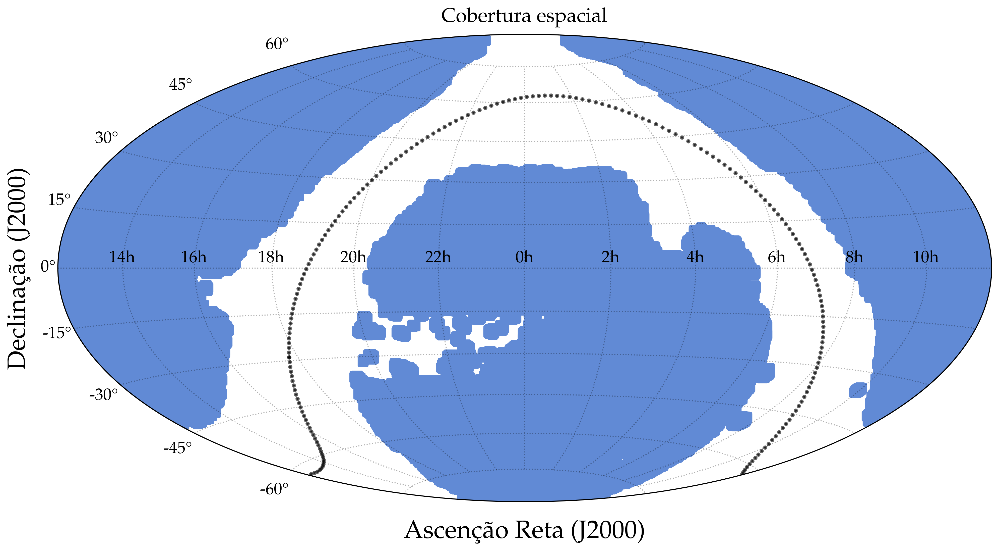

In [5]:
# plot_splus_footprint(save_path='plots/splus_footprint.pdf')
# plot_sdss_footprint(save_path='plots/sdss_footprint.pdf')
plot_legacy_footprint(save_path='plots/footprint_legacy.pdf')
# read_image('splus.jpg')[150:-150,300:-300,:].shape

In [10]:
df = read_table('~/Downloads/gz_evo+ls10.parquet')

In [43]:
mask = (df.columns.str.contains('hubble'))# & df.columns.str.contains('total-votes'))
# mask = np.ones(shape=(len(df.columns),), dtype=bool)
print(*df.columns[mask], sep=', ')
# print(len(df.columns[mask]))
# total_votes = 0
# max_votes = 0
# for c in df.columns[mask]:
#   s = df[c].sum()
#   total_votes += s
#   if s > max_votes:
#     max_votes = s
# print('total:', total_votes, 'max:', max_votes)

smooth-or-featured-hubble_smooth, smooth-or-featured-hubble_smooth_fraction, smooth-or-featured-hubble_total-votes, smooth-or-featured-hubble_features, smooth-or-featured-hubble_features_fraction, smooth-or-featured-hubble_artifact, smooth-or-featured-hubble_artifact_fraction, how-rounded-hubble_completely, how-rounded-hubble_completely_fraction, how-rounded-hubble_total-votes, how-rounded-hubble_in-between, how-rounded-hubble_in-between_fraction, how-rounded-hubble_cigar-shaped, how-rounded-hubble_cigar-shaped_fraction, clumpy-appearance-hubble_yes, clumpy-appearance-hubble_yes_fraction, clumpy-appearance-hubble_total-votes, clumpy-appearance-hubble_no, clumpy-appearance-hubble_no_fraction, clump-count-hubble_1, clump-count-hubble_1_fraction, clump-count-hubble_total-votes, clump-count-hubble_2, clump-count-hubble_2_fraction, clump-count-hubble_3, clump-count-hubble_3_fraction, clump-count-hubble_4, clump-count-hubble_4_fraction, clump-count-hubble_5-plus, clump-count-hubble_5-plus_fr

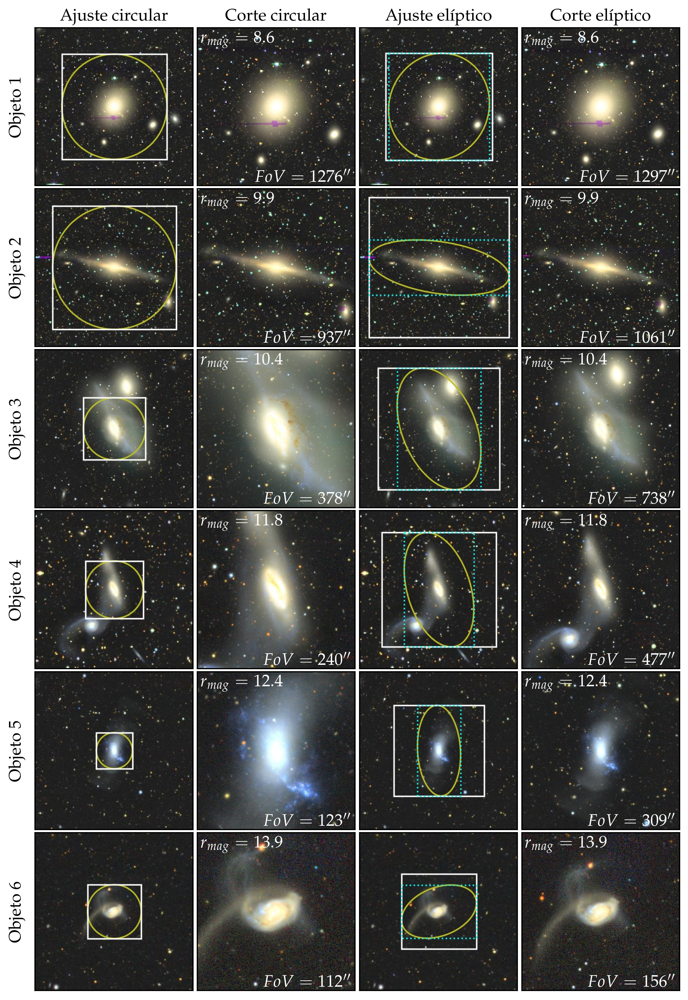

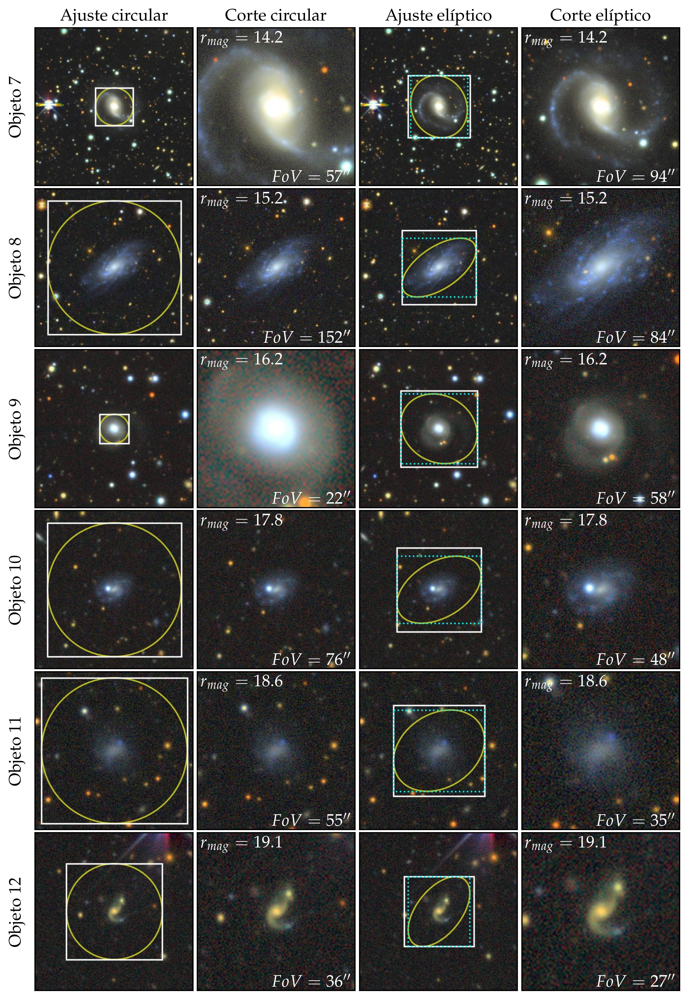

In [13]:
def plot_stamps(rng, fname):
  FONT_SIZE = 7
  STAMP_SIZE = 150
  
  objects = [
    {'ra': 187.7059, 'dec': 12.3912, 'r50': 55.4682, 'mag_r': 8.629, 'e1': 0.0287, 'e2': -0.0311, 'base_pixscale': 5},
    {'ra': 200.0701, 'dec': -21.8273, 'r50': 80.7815, 'mag_r': 9.94, 'e1': -0.4434, 'e2': 0.1328, 'base_pixscale': 5},
    {'ra': 186.9401, 'dec': 13.0087, 'r50': 30.9466, 'mag_r': 10.398, 'e1': 0.1911, 'e2': 0.1892, 'base_pixscale': 5},
    {'ra': 146.4248, 'dec': -14.3268, 'r50': 22.2206, 'mag_r': 11.809, 'e1': 0.2505, 'e2': 0.1673, 'base_pixscale': 3},
    {'ra': 43.6397, 'dec': -10.0285, 'r50': 11.7247, 'mag_r': 12.429, 'e1': 0.3555, 'e2': 0.0397, 'base_pixscale': 3},
    {'ra': 140.8713, 'dec': 25.7695, 'r50': 11.0985, 'mag_r': 13.902, 'e1': -0.1743, 'e2': -0.1583, 'base_pixscale': 3},
    
    {'ra': 301.1921, 'dec': -57.6799, 'r50': 5.7659, 'mag_r': 14.242, 'e1': 0.0466, 'e2': 0.0540, 'base_pixscale': 0.5},
    {'ra': 71.8302, 'dec': -4.2013, 'r50': 15.6476, 'mag_r': 15.218, 'e1': -0.1265, 'e2': -0.3154, 'base_pixscale': 0.5},
    {'ra': 246.9125, 'dec': 8.8070, 'r50': 2.3208, 'mag_r': 16.224, 'e1': -0.0457, 'e2': 0.0777, 'base_pixscale': 0.5},
    {'ra': 163.0393, 'dec': 0.0126, 'r50': 8.1744, 'mag_r': 17.775, 'e1': -0.1179, 'e2': -0.2158, 'base_pixscale': 0.5},
    {'ra': 305.5820, 'dec': -47.9301, 'r50': 6.0684, 'mag_r': 18.607, 'e1': -0.0573, 'e2': -0.1295, 'base_pixscale': 0.5},
    {'ra': 1.7160, 'dec': -42.1761, 'r50': 4.0866, 'mag_r': 19.088, 'e1': 0.0673, 'e2': -0.2834, 'base_pixscale': 0.5},
  ]
  df = pd.DataFrame(objects)
  
  fig, axs = plt.subplots(6, 4, figsize=(4.8, 7.2))
  for i, (k, row) in enumerate(df.iloc[slice(*rng)].iterrows()):
    axs[i, 0].imshow(read_image(Path('stamps') / f'obj{k+1}_c+bb.jpg'))
    axs[i, 1].imshow(read_image(Path('stamps') / f'obj{k+1}_c.jpg'))
    axs[i, 2].imshow(read_image(Path('stamps') / f'obj{k+1}_e+bb.jpg'))
    axs[i, 3].imshow(read_image(Path('stamps') / f'obj{k+1}_e.jpg'))
    axs[i, 0].set_ylabel(f'Objeto {k+1}', size=FONT_SIZE)
    axs[i, 0].tick_params(pad=1)
    fov = compute_fov_circ(row.r50, row.mag_r, 'step')
    axs[i, 1].text(0.97, 0.025, f"$FoV = {fov:.0f}''$", ha='right', fontsize=FONT_SIZE, c='white', transform=axs[i, 1].transAxes)
    axs[i, 1].text(0.02, 0.98, f'$r_{{mag}} = {row.mag_r:.1f}$', fontsize=FONT_SIZE, c='white', va='top', transform=axs[i, 1].transAxes)
    fov = compute_fov_ellip(row.e1, row.e2, row.mag_r, 'step')
    axs[i, 3].text(0.97, 0.025, f"$FoV = {fov:.0f}''$", ha='right', fontsize=FONT_SIZE, c='white', transform=axs[i, 3].transAxes)
    axs[i, 3].text(0.02, 0.98, f'$r_{{mag}} = {row.mag_r:.1f}$', fontsize=FONT_SIZE, c='white', va='top', transform=axs[i, 3].transAxes)
    for j in range(4):
      axs[i, j].set_xticks([])
      axs[i, j].set_yticks([])
    if i == 0:
      axs[i, 0].set_title('Ajuste circular', size=FONT_SIZE, pad=3)
      axs[i, 1].set_title('Corte circular', size=FONT_SIZE, pad=3)
      axs[i, 2].set_title('Ajuste elíptico', size=FONT_SIZE, pad=3)
      axs[i, 3].set_title('Corte elíptico', size=FONT_SIZE, pad=3)
  
  plt.subplots_adjust(hspace=0.02, wspace=0.02)
  plt.savefig(f'plots/{fname}', bbox_inches='tight', pad_inches=0.01)
  plt.show()

plot_stamps([0, 6], 'stamps_crop_1.pdf')
plot_stamps([6, 12], 'stamps_crop_2.pdf')

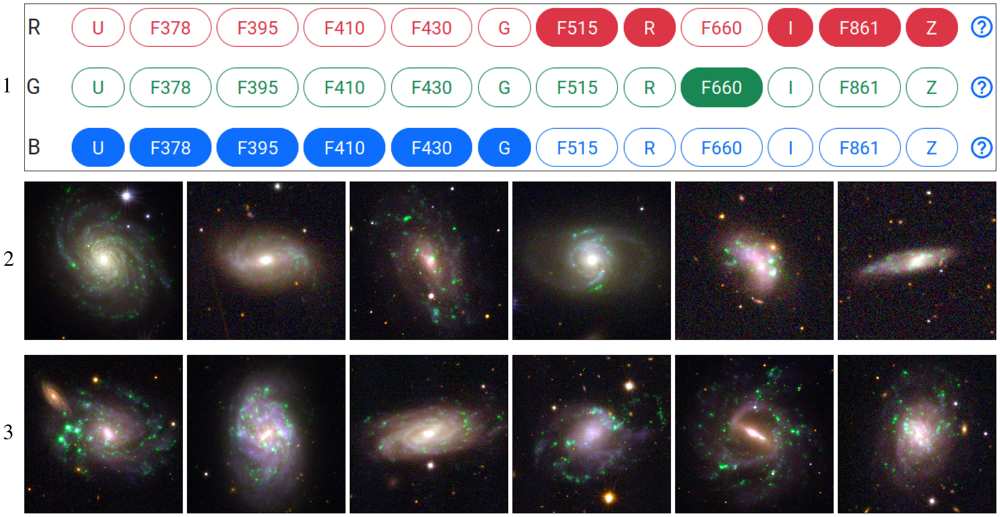

In [17]:
def plot_splus_stamps():
  data = [
    dict(ra=180.09845909847544, dec=-1.100368742093693, size=380),
    dict(ra=186.4280295322849, dec=0.5727070967999205, size=280),
    dict(ra=188.117563525288, dec=0.3900396135435521, size=410),
    dict(ra=180.67602, dec=1.9767987, size=275),
    dict(ra=180.2968184205, dec=-1.29584965385, size=250),
    dict(ra=185.14071, dec=0.78821212, size=275), # +/-
    # dict(ra=179.79283333333, dec=-2.59088888889, size=275),
    # dict(ra=185.08883333333, dec=0.3675, size=275),
    # dict(ra=156.9637, dec=-43.9038, size=280),
    dict(ra=18.8783, dec=-0.8608, size=360),
    dict(ra=41.6055, dec=-0.4988, size=385),
    dict(ra=41.6412, dec=-0.2472, size=420),
    dict(ra=18.2324, dec=0.981, size=535),
    dict(ra=40.9179, dec=1.3758, size=530),
    dict(ra=37.1164, dec=-1.1512, size=310),
  ]
  
  # 18.231995743028605,0.9814924482360567
  # 18.8765,-0.8612
  # 49.30489841199487,-32.575875778017206
  # 33.958206380168214,-31.201184364323
  # 50.26440057964245,-37.10184435059375
  
  
  df = pd.DataFrame(data)
  df['path'] = [Path('splus_stamps') / f'{iauname(row.ra, row.dec)}_{row["size"]}.png' for i, row in df.iterrows()]
  
  s = SplusService(os.environ.get('SPLUS_USER'), os.environ.get('SPLUS_PASS'))
  for i, row in df.iterrows():
    s.download_trilogy_rgb(
      ra=row.ra, 
      dec=row.dec, 
      save_path=row.path, 
      size=row['size'], 
      r_band=['R', 'I', 'F861', 'Z', 'F515'], 
      g_band=['F660'], 
      b_band=['G', 'U', 'F378', 'F395', 'F410', 'F430'], 
      saturation=0.2
    )
  
  fig = plt.figure(figsize=(16, 8.6))

  gs = fig.add_gridspec(3, 6)
  ax = fig.add_subplot(gs[0, :])
  ax.imshow(read_image('trilogy_controls2.png'))
  ax.set_ylabel('1', va='center', size=20, labelpad=14, rotation=0)
  ax.set_xticks([])
  ax.set_yticks([])
  
  def plot_img_row(ax, fname, i, row_number):
    ax.imshow(read_image(fname))
    ax.set_xticks([])
    ax.set_yticks([])
    if i == 0:
      ax.set_ylabel(row_number, va='center', size=20, labelpad=14, rotation=0)
  
  for i, fname in enumerate(df.path.values[:6]):
    ax = fig.add_subplot(gs[1, i])
    plot_img_row(ax, fname, i, '2')
  
  for i, fname in enumerate(df.path.values[6:]):
    ax = fig.add_subplot(gs[2, i])
    plot_img_row(ax, fname, i, '3')
  
  plt.subplots_adjust(hspace=0.01, wspace=0.03)
  plt.savefig('plots/splus_emission.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()
  
plot_splus_stamps()

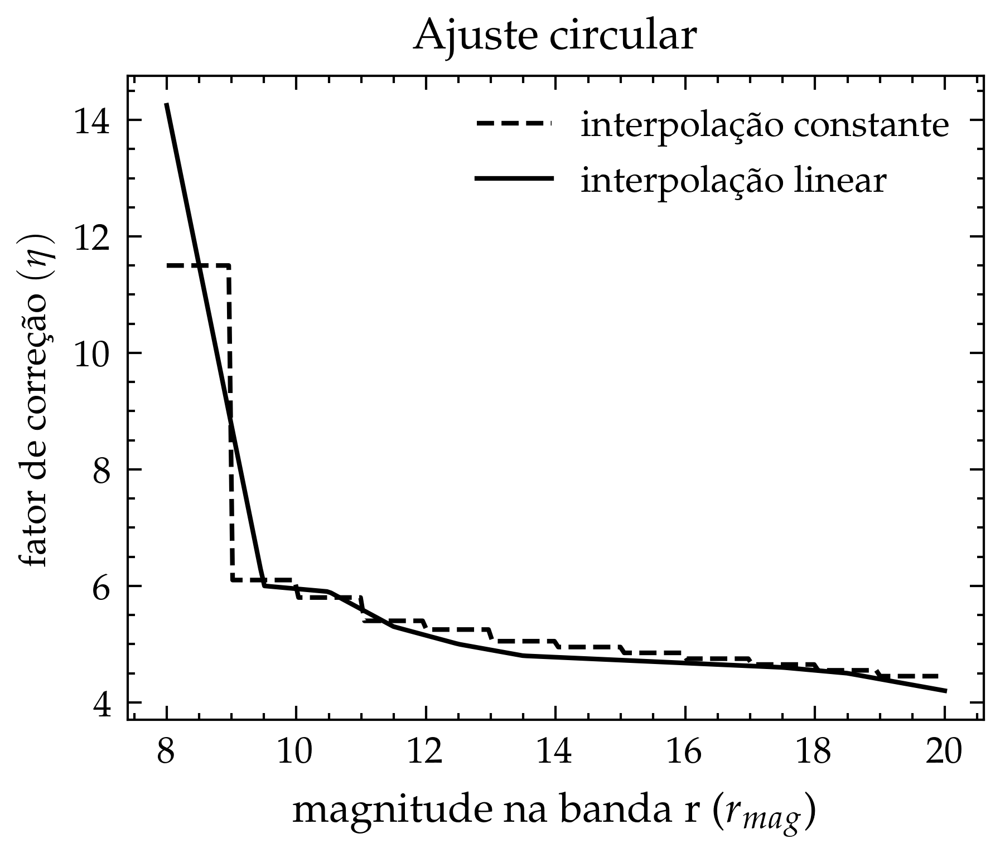

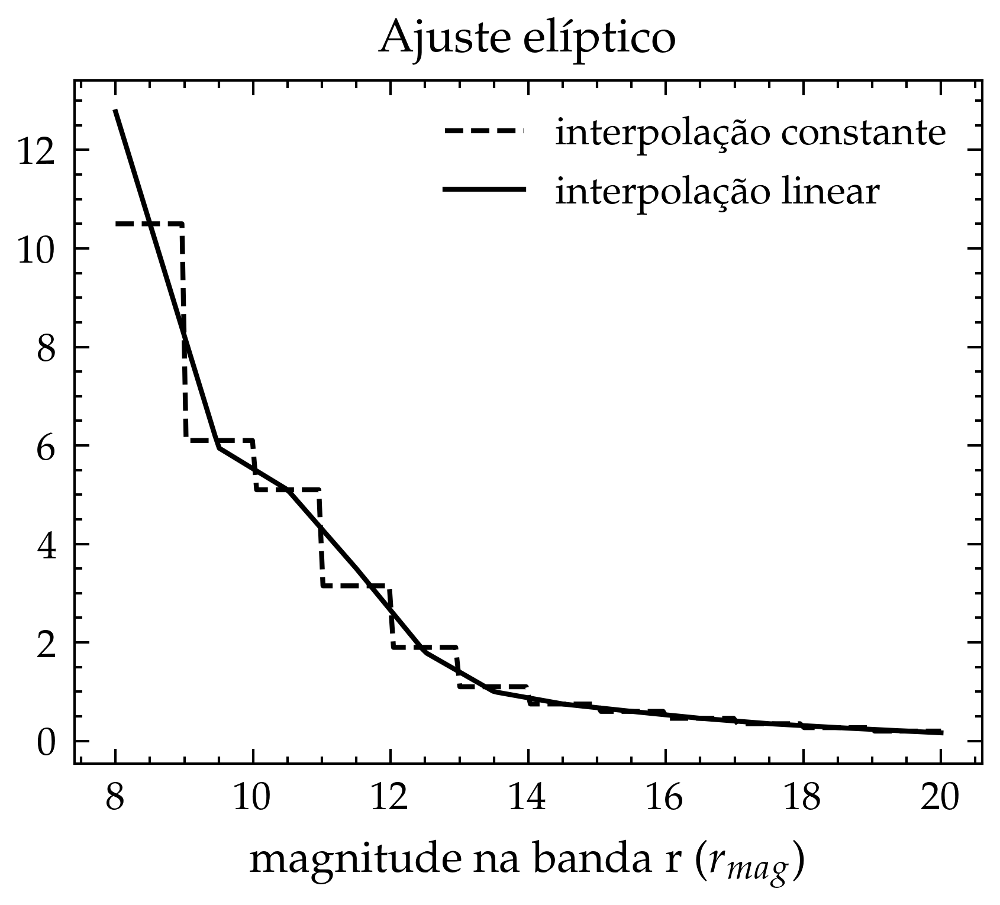

In [22]:
def plot_correction_factor_circ():
  df = read_table(configs.CORRECTION_FACTOR)
  plt.figure()
  # step interp
  x = np.linspace(df.mag_r.min(), df.mag_r.max()+.9, 200)
  y = correction_factor_circle(x, 'step')
  r1 = y[(x > 9) & (x < 10)]
  r2 = y[(x > 10) & (x < 11)]
  y[(x > 9) & (x < 10)] = r2
  y[(x > 10) & (x < 11)] = r1
  plt.plot(x, y, c='k', ls='--', label='interpolação constante')
  
  # linear interp
  x = np.linspace(df.mag_r.min(), df.mag_r.max()+1, 200)
  y = correction_factor_circle(x, 'linear')
  plt.plot(x, y, c='k', ls='-', label='interpolação linear')
  
  # plot settings
  plt.xlabel('magnitude na banda r ($r_{{mag}}$)', size=9)
  plt.ylabel('fator de correção $(\\eta)$')
  plt.title('Ajuste circular')
  plt.legend()
  plt.savefig('plots/correction_factor_circ.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()
  plt.close()
  
def plot_correction_factor_ellip():
  df = read_table(configs.CORRECTION_FACTOR)
  plt.figure()
  # step interp
  x = np.linspace(df.mag_r.min(), df.mag_r.max()+1, 200)
  y = correction_factor_ellipse(x, 'step')
  plt.plot(x, y, c='k', ls='--', label='interpolação constante')
  
  # linear interp
  x = np.linspace(df.mag_r.min(), df.mag_r.max()+1, 200)
  y = correction_factor_ellipse(x, 'linear')
  plt.plot(x, y, c='k', ls='-', label='interpolação linear')
  
  # plot settings
  plt.xlabel('magnitude na banda r ($r_{{mag}}$)', size=9)
  # plt.ylabel('fator de correção $(\\eta)$')
  plt.title('Ajuste elíptico')
  plt.legend()
  plt.savefig('plots/correction_factor_ellip.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()
  plt.close()

plot_correction_factor_circ()
plot_correction_factor_ellip()

In [2]:
def download_sdss_spec(ra: float, dec: float):
  out_path = Path(f'sed/{iauname(ra, dec)}_sdss.png')
  if out_path.exists(): 
    return
  objid_url = 'https://skyserver.sdss.org/dr18/SkyServerWS/SpectroQuery/ConeSpectro'
  resp = requests.get(objid_url, params=dict(ra=ra, dec=dec, radius=0.01667, limit=1, format='csv', specparams='specObjID', imgparams='none', zWarning='on'))
  df = pd.read_csv(StringIO(resp.text), comment='#')
  if 'specObjID' in df.columns:
    id = df.loc[0, 'specObjID']
    resp = requests.get('https://astrotools.vercel.app/spec', params=dict(id=id))
    Image.open(BytesIO(resp.content)).save(out_path)


def download_splus_sed(ra: float, dec: float):
  out_path = Path(f'sed/{iauname(ra, dec)}_splus.png')
  if out_path.exists(): 
    return
  resp = requests.get('https://astrotools.vercel.app/plot', params=dict(ra=ra,dec=dec,iso='',aper6='',aper3='',auto='',petro='',pstotal=''))
  Image.open(BytesIO(resp.content)).save(out_path)



def download_splus_stamp(ra: float, dec: float, size=300, overwrite=False):
  out_path = Path(f'sed/{iauname(ra, dec)}_splus_stamp.png')
  if not overwrite and out_path.exists(): 
    return
  s = SplusService(os.environ['SPLUS_USER'], os.environ['SPLUS_PASS'])
  s.download_trilogy_rgb(
    ra=ra, 
    dec=dec, 
    save_path=out_path, 
    size=size, 
    r_band=['R', 'I', 'F861', 'Z', 'F515'], 
    g_band=['F660'], 
    b_band=['G', 'U', 'F378', 'F395', 'F410', 'F430'], 
    saturation=0.2
  )
  

def download_legacy_stamp(ra: float, dec: float, size=300, overwrite=False,):
  out_path = Path(f'sed/{iauname(ra, dec)}_legacy_stamp.png')
  if out_path.exists(): 
    return
  cutout(ra=ra, dec=dec, save_path=out_path, size=size, pixscale=0.55, overwrite=overwrite)


def plot_sed():
  objects = [
    dict(ra=14.76707668879327, dec=1.0011688667198562, size=120),
    dict(ra=18.03228185021425, dec=-1.000599229371605, size=120),
  ]
  overwrite = False
  for i, obj in enumerate(objects):
    download_sdss_spec(obj['ra'], obj['dec'])
    download_splus_sed(obj['ra'], obj['dec'])
    download_splus_stamp(obj['ra'], obj['dec'], obj['size'], overwrite=overwrite)
    download_legacy_stamp(obj['ra'], obj['dec'], obj['size'], overwrite=overwrite)
    
    
  

In [2]:
df = read_table('~/Downloads/gz_evo+ls10.parquet')
df = df[df.mag_r.between(12, 23)]

In [5]:
print(*df.columns, sep=', ')

dataset_name, ra, dec, smooth-or-featured-gz2_smooth, smooth-or-featured-gz2_smooth_fraction, smooth-or-featured-gz2_total-votes, smooth-or-featured-gz2_featured-or-disk, smooth-or-featured-gz2_featured-or-disk_fraction, smooth-or-featured-gz2_artifact, smooth-or-featured-gz2_artifact_fraction, disk-edge-on-gz2_yes, disk-edge-on-gz2_yes_fraction, disk-edge-on-gz2_total-votes, disk-edge-on-gz2_no, disk-edge-on-gz2_no_fraction, has-spiral-arms-gz2_yes, has-spiral-arms-gz2_yes_fraction, has-spiral-arms-gz2_total-votes, has-spiral-arms-gz2_no, has-spiral-arms-gz2_no_fraction, bar-gz2_yes, bar-gz2_yes_fraction, bar-gz2_total-votes, bar-gz2_no, bar-gz2_no_fraction, bulge-size-gz2_dominant, bulge-size-gz2_dominant_fraction, bulge-size-gz2_total-votes, bulge-size-gz2_obvious, bulge-size-gz2_obvious_fraction, bulge-size-gz2_just-noticeable, bulge-size-gz2_just-noticeable_fraction, bulge-size-gz2_no, bulge-size-gz2_no_fraction, something-odd-gz2_yes, something-odd-gz2_yes_fraction, something-odd

In [20]:
from sklearn.model_selection import train_test_split


np.histogram(df.mag_r.values, bins=22)

# train_test_split((df.mag_r.values, ), 0.3, random_state=42, stratify=True)
# df.mag_g

(array([   177,    471,   1002,   2223,   4638,   8828,  17946,  40609,
         85968, 122182,  89479,  61340,  36733,  44152,   6055,   1919,
          2475,   3392,   5079,   7479,  11451,  18010]),
 array([12.00427 , 12.504075, 13.00388 , 13.503685, 14.00349 , 14.503295,
        15.0031  , 15.502905, 16.00271 , 16.502515, 17.00232 , 17.502125,
        18.00193 , 18.501735, 19.00154 , 19.501345, 20.00115 , 20.500955,
        21.00076 , 21.500565, 22.00037 , 22.500175, 22.99998 ]))

In [117]:
def plot_conjuntos_magr():
  df = read_table('~/Downloads/gz_evo+ls10.parquet')
  df = df[df.mag_r.between(12, 23)]
  
  counts, edges = np.histogram(df.mag_r.values, bins=22)
  counts = counts * 100 / len(df.mag_r.values)
  rng = np.random.default_rng(42)
  noise1 = rng.uniform(-0.4, 1, 22)
  noise2 = rng.uniform(-0.4, 1, 22)
  counts_val = counts.copy()
  counts_val[4:] += noise1[4:]
  counts_val[:4] += 0.2*noise1[:4]
  counts_val = np.clip(counts_val, 0, 100)
  counts_test = counts.copy()
  counts_test[4:] += noise2[4:]
  counts_test[:4] += 0.1*noise2[:4]
  counts_test = np.clip(counts_test, 0, 100)
  
  plt.figure(figsize=(5.5, 3.5))
  plt.stairs(counts, edges, fill=False, label='Treinamento', color='k')
  plt.stairs(counts_val, edges, fill=False, label='Validação', ls='--', color='tab:orange')
  plt.stairs(counts_test, edges, fill=False, label='Teste', ls=(0, (1, 1)), color='tab:blue')
  plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(decimals=0))
  plt.ylabel('Densidade')
  plt.xlabel('Magnitude na banda r ($r_{{mag}}$)')
  plt.legend()
  plt.savefig('plots/conjuntos_magr.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()


def plot_conjuntos_fov():
  df = read_table('~/Downloads/gz_evo+ls10.parquet')
  df = df[df.mag_r.between(12, 23)]
  
  fov = compute_fov_ellip(df.shape_e1.values, df.shape_e2.values, df.mag_r.values, 'step')
  fov = fov[fov < 150]
  
  counts, edges = np.histogram(fov, bins=22)
  counts = counts * 100 / len(fov)
  rng = np.random.default_rng(42)
  noise1 = rng.uniform(-0.7, 1.1, 22)
  noise2 = rng.uniform(-0.6, 1.1, 22)
  counts_val = counts.copy()
  i = 16
  counts_val[i:] += 0.1*noise1[i:]
  counts_val[:i] += noise1[:i]
  counts_val = np.clip(counts_val, 0, 100)
  counts_test = counts.copy()
  counts_test[i:] += 0.1*noise2[i:]
  counts_test[:i] += noise2[:i]
  counts_test = np.clip(counts_test, 0, 100)
  
  plt.figure(figsize=(5.5, 3.5))
  plt.stairs(counts, edges, fill=False, label='Treinamento', color='k')
  plt.stairs(counts_val, edges, fill=False, label='Validação', ls='--', color='tab:orange')
  plt.stairs(counts_test, edges, fill=False, label='Teste', ls=(0, (1, 1)), color='tab:blue')
  plt.gca().yaxis.set_major_formatter(mtick.PercentFormatter(decimals=0))
  plt.ylabel('Densidade')
  plt.xlabel('Campo de visão angular (arcsec)')
  plt.legend()
  plt.savefig('plots/conjuntos_fov.pdf', bbox_inches='tight', pad_inches=0.01)
  plt.show()
  
def plot_conjuntos_footprint(ax: plt.Axes = None, save_path=None):
  if ax is None:
    fig = plt.figure(figsize=(8,6))
    ax = fig.add_subplot(111, projection='hammer')
  
  df = read_table('~/Downloads/gz_evo+ls10.parquet')
  df = df[df.mag_r.between(0, 23)]
  df = df.sample(frac=1).reset_index(drop=True)
  ra = Angle(df['ra'].values*u.deg)
  ra = ra.wrap_at(180*u.deg)
  dec = Angle(df['dec'].values*u.deg)
  
  ra_train = ra[:int(len(ra)*.7)]
  dec_train = dec[:int(len(dec)*.7)]
  
  ra_val = ra[int(len(ra)*.7):int(len(ra)*.8)]
  dec_val = dec[int(len(dec)*.7):int(len(dec)*.8)]
  
  ra_test = ra[int(len(ra)*.8):]
  dec_test = dec[int(len(dec)*.8):]
  
  print(len(ra_train), len(ra_val), len(ra_test))

  ax.scatter(ra_val.rad, dec_val.rad, label='Validação', c='tab:red', marker='.', s=0.4, alpha=0.1, rasterized=True)
  ax.scatter(ra_test.rad, dec_test.rad, label='Teste', c='tab:orange', marker='.', s=0.4, alpha=0.1, rasterized=True)
  ax.scatter(ra_train.rad, dec_train.rad, label='Treinamento', c='tab:blue', marker='.', s=0.4, alpha=0.1, rasterized=True)

  ytickslabels = ax.yaxis.get_ticklabels()
  ytickslabels[0].set_text('')
  ytickslabels[-1].set_text('')
  ax.set_yticklabels(ytickslabels)
  ax.set_xticklabels(RA_LABELS)
  ax.grid(True, color='k', alpha=0.3, linestyle=':')
  ax.set_xlabel('Ascenção Reta (J2000)', fontsize=label_fontsize, labelpad=xlabelpad)
  ax.set_ylabel('Declinação (J2000)', fontsize=label_fontsize)
  # ax.set_title('SDSS DR18', fontsize=title_fontsize)
  plot_mw(ax)
  if save_path:
    plt.savefig(save_path, bbox_inches='tight', pad_inches=0.01)


# plot_conjuntos_fov()
# plot_conjuntos_magr()

In [24]:
cm_meta = [
  {
    'cm': [
      [146, 30, 2],
      [30, 112, 16],
      [1, 16, 28]
    ],
    'title': 'Spiral winding',
    'labels': ['Loose', 'Medium', 'Tight'],
  },
  {
    'cm': [
      [46, 8, 2],
      [16, 55, 15],
      [9, 38, 348]
    ],
    'title': 'Bar',
    'labels': ['Strong', 'Weak', 'No'],
  },
  {
    'cm': [
      [14, 2, 1],
      [0, 34, 2],
      [6, 8, 156]
    ],
    'title': 'Edge on bulge',
    'labels': ['Boxy', 'None', 'Rounded'],
  },
  {
    'cm': [
      [412, 16],
      [19, 878],
    ],
    'title': 'Disk edge on',
    'labels': ['Yes', 'No'],
  },
  {
    'cm': [
      [2789, 74, 0],
      [71, 932, 0],
      [0, 0, 0]
    ],
    'title': 'Smooth or featured',
    'labels': ['Smooth', 'Featured/Disk', 'Artifact'],
    'label_rotation': 25,
  },
  {
    'cm': [
      [702, 17],
      [31, 89],
    ],
    'title': 'Has spiral arms',
    'labels': ['Yes', 'No'],
  },
  {
    'cm': [
      [777, 8],
      [12, 203],
    ],
    'title': 'Galaxy Symetrical',
    'labels': ['Yes', 'No'],
  },
  {
    'cm': [
      [412, 13],
      [11, 197],
    ],
    'title': 'Clumpy appearence',
    'labels': ['Yes', 'No'],
  },
  {
    'cm': [
      [1235, 111, 1],
      [171, 3012, 48],
      [0, 46, 640]
    ],
    'title': 'How rounded',
    'labels': ['Round', 'In between', 'Cigar'],
  },
  {
    'cm': [
      [4987, 56, 28, 34],
      [9, 22, 4, 5],
      [14, 8, 89, 6],
      [20, 4, 15, 156]
    ],
    'title': 'Merging',
    'labels': ['None', 'Minor', 'Major', 'Merger'],
  },
  {
    'cm': [
      [10, 2, 1, 0, 0],
      [2, 8, 4, 0, 1],
      [1, 5, 224, 12, 9],
      [0, 1, 37, 161, 5],
      [0, 1, 1, 3, 11],
    ],
    'title': 'Bulge size',
    'labels': ['Dominant', 'Large', 'Moderate', 'Small', 'None'],
    'label_rotation': 25,
  },
  {
    'cm': [
      [9, 3, 1, 0, 0, 1],
      [11, 315, 9, 2, 0, 11],
      [0, 4, 21, 1, 0, 3],
      [1, 0, 1, 12, 2, 0],
      [0, 2, 0, 1, 10, 0],
      [0, 4, 3, 2, 1, 32],
    ],
    'title': 'Spiral arms count',
    'labels': ['1', '2', '3', '4', '$>$4', '?'],
  },
]

def plot_cm(meta, ax):
  cm = np.asarray(meta['cm'])
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
  cm = np.nan_to_num(cm, nan=0)
  d = ConfusionMatrixDisplay(cm*100, display_labels=meta['labels'])
  d.plot(cmap='Blues', values_format='.1f', colorbar=False, xticks_rotation=meta.get('label_rotation', 0), ax=ax)
  ax.tick_params(labelsize=6.5)
  ax.set_title(f'Questão: {meta['title']}')
  ax.set_ylabel('Rótulo verdadeiro')
  ax.set_xlabel('Rótulo previsto')
  

def plot_cm_grid(fname, meta, rows, cols, figsize=(4.2, 7), wspace=None):
  fig, axs = plt.subplots(rows, cols, figsize=figsize)
  for i, m in enumerate(meta):
    row = i // 2
    col = i % 2
    ax = axs[row, col]
    plot_cm(m, ax)
    if col != 0:
      ax.set_ylabel(None)
    if row != rows - 1:
      ax.set_xlabel(None)
  if wspace:
    plt.subplots_adjust(wspace=wspace)
  plt.savefig(fname, bbox_inches='tight', pad_inches=0.01)
  plt.draw()


def cm_params(k, cm):
  TP = cm[k, k]
  FN = cm[k].sum() - TP
  FP = cm[:, k].sum() - TP
  TN = cm.sum() - TP - FN - FP
  return TP, FN, FP, TN


def compute_metrics(tp, fn, fp, tn):
  acc = (tp + tn) / (tp + tn + fp + fn)
  pre = tp / (tp + fp)
  rec = tp / (tp + fn)
  f1 = 2*(pre * rec) / (pre + rec)
  return acc, pre, rec, f1

def compute_all_metrics():
  all_metrics = []
  for m in cm_meta:
    cm = np.asarray(m['cm'])
    metrics = np.asarray([compute_metrics(*cm_params(i, cm)) for i in range(cm.shape[0])]).mean(axis=0)
    all_metrics.append(metrics)
  
  all_metrics = np.asarray(all_metrics)
  df = pd.DataFrame(all_metrics, columns=['Acurácia', 'Precisão', 'Revocação', 'F1'])
  df.insert(0, 'Questão', [m['title'] for m in cm_meta])
  df.to_latex(sys.stdout, index=False)

compute_all_metrics()
# plot_cm_grid('plots/cm_1.pdf', cm_meta[:6], 3, 2, (4.2, 7), 0.32)
# plot_cm_grid('plots/cm_2.pdf', cm_meta[6:], 3, 2, (4.2, 7), 0.28)

\begin{tabular}{lrrrr}
\toprule
Questão & Acurácia & Precisão & Revocação & F1 \\
\midrule
Spiral winding & 0.833771 & 0.714138 & 0.717103 & 0.715594 \\
Bar & 0.890751 & 0.715289 & 0.780659 & 0.742811 \\
Edge on bulge & 0.943199 & 0.817953 & 0.895207 & 0.851695 \\
Disk edge on & 0.973585 & 0.969010 & 0.970718 & 0.969856 \\
Smooth or featured & 0.974996 & NaN & NaN & NaN \\
Has spiral arms & 0.942789 & 0.898665 & 0.859011 & 0.877276 \\
Galaxy Symetrical & 0.980000 & 0.973438 & 0.966997 & 0.970173 \\
Clumpy appearence & 0.962085 & 0.956045 & 0.958264 & 0.957141 \\
How rounded & 0.952254 & 0.919239 & 0.927339 & 0.923121 \\
Merging & 0.981400 & 0.666607 & 0.771892 & 0.703503 \\
Bulge size & 0.931864 & 0.683324 & 0.734342 & 0.701055 \\
Spiral arms count & 0.954545 & 0.684281 & 0.758884 & 0.716117 \\
\bottomrule
\end{tabular}


/tmp/ipykernel_69372/1824698439.py:155: RuntimeWarning: invalid value encountered in scalar divide
  pre = tp / (tp + fp)
/tmp/ipykernel_69372/1824698439.py:156: RuntimeWarning: invalid value encountered in scalar divide
  rec = tp / (tp + fn)
